In [1]:
import numpy as np
from tensorflow.keras import optimizers
from dataset import Dataset
from model_and_evaluation import *
import matplotlib.pyplot as plt
from scipy.signal import find_peaks

## Import Datasets


In [2]:
train_ds = Dataset(type="Train", resolution="Mid", context=16, smear=1, n_songs=10)

10
----------------------------------------------------------------------------------


Train dataset Mid_16

Total examples : 14497.  Positive Labeled: 1512, 10.4%
Shape of samples : (114, 80, 1). Total songs: 10  

.....................................................................................


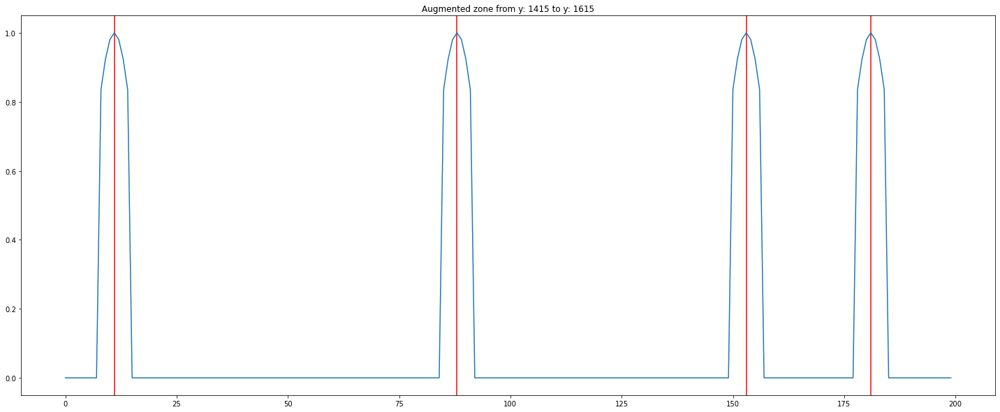

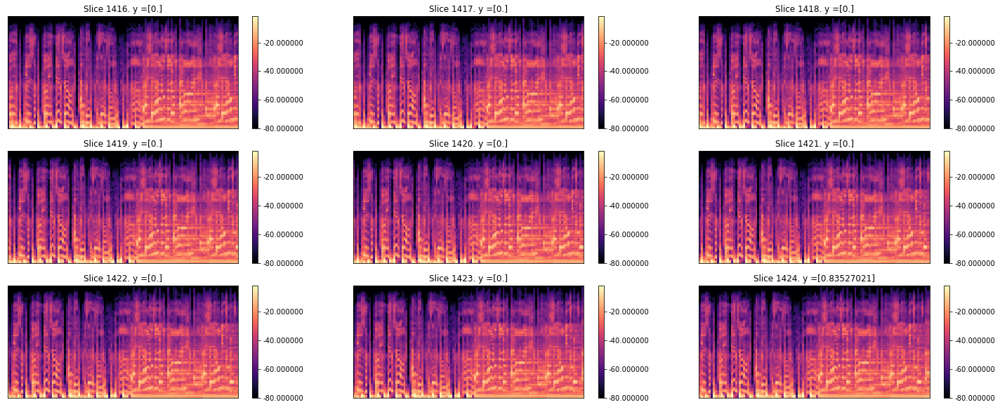

In [6]:
train_ds.show_features(n_song=2, slice  = 200)
train_ds.play_song(n_song=1)

In [3]:
#boosting the percentage of positive examples, 
#you must shuffle the dataset before training!!
train_ds.boost_positives(3)

----------------------------------------------------------------------------------


Train dataset Mid_16

Total examples : 198865.  Positive Labeled: 50748, 25.5%
Shape of samples : (114, 80, 1). Total songs: 116  

.....................................................................................


In [4]:
# Create validation dataset
val_ds = Dataset(type="Val", resolution="Mid", context=16, smear=1, n_songs=10)

10
----------------------------------------------------------------------------------


Val dataset Mid_16

Total examples : 13773.  Positive Labeled: 1120, 8.1%
Shape of samples : (114, 80, 1). Total songs: 10  

.....................................................................................


## Build the model

In [5]:
input_shape = train_ds.X_data.shape[1:]
model = build_model(input_shape)

In [12]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 114, 80, 16)       784       
_________________________________________________________________
batch_normalization_2 (Batch (None, 114, 80, 16)       64        
_________________________________________________________________
activation_2 (Activation)    (None, 114, 80, 16)       0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 38, 14, 16)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 38, 14, 32)        9248      
_________________________________________________________________
batch_normalization_3 (Batch (None, 38, 14, 32)        128       
_________________________________________________________________
activation_3 (Activation)    (None, 38, 14, 32)       

## Compile the network

In [6]:
optimizer = optimizers.SGD(learning_rate=0.05, momentum=0.45)
model.compile(optimizer=optimizer,
              loss='binary_crossentropy',
              metrics=['accuracy']
)

## Train the CNN

In [7]:
batch_size = 64
#learning rate schedule
lrate = LearningRateScheduler(step_decay)
#early stopping to avoid overfitting
es = EarlyStopping(monitor='val_loss', mode='min', patience=3)


In [8]:
model.fit(train_ds.X_data,
          train_ds.Y_data,
          validation_data=(val_ds.X_data, val_ds.oY_data),
          batch_size=batch_size,
          epochs=20,
          shuffle = True,
          callbacks = []
         )


Epoch 1/20
3108/3108 [==============================] - 93s 23ms/step - loss: 0.5752 - accuracy: 0.7399 - val_loss: 0.2644 - val_accuracy: 0.9876
Epoch 2/20
3108/3108 [==============================] - 42s 14ms/step - loss: 0.5307 - accuracy: 0.7400 - val_loss: 0.2539 - val_accuracy: 0.9572
Epoch 3/20
3108/3108 [==============================] - 42s 13ms/step - loss: 0.5032 - accuracy: 0.7359 - val_loss: 0.2371 - val_accuracy: 0.9746
Epoch 4/20
3108/3108 [==============================] - 42s 14ms/step - loss: 0.4555 - accuracy: 0.7361 - val_loss: 0.2365 - val_accuracy: 0.9741
Epoch 5/20
3108/3108 [==============================] - 42s 14ms/step - loss: 0.3980 - accuracy: 0.7384 - val_loss: 0.1942 - val_accuracy: 0.9726
Epoch 6/20
3108/3108 [==============================] - 42s 14ms/step - loss: 0.3348 - accuracy: 0.7424 - val_loss: 0.1197 - val_accuracy: 0.9861
Epoch 7/20
3108/3108 [==============================] - 42s 14ms/step - loss: 0.2830 - accuracy: 0.7485 - val_loss: 0.1527 -

## Save Model

In [9]:
save_model(model, "Mid_16_1_Dropout_5")

Saved model to disk


In [10]:
del model # to save space on disk.

## Import Test Set

In [8]:
test_ds = Dataset(type="Test", resolution="Low", context=16, smear=1.5, n_songs=20)

20
----------------------------------------------------------------------------------


Test dataset Low_16

Total examples : 15308.  Positive Labeled: 2152, 14.099999999999998%
Shape of samples : (58, 80, 1). Total songs: 20  

.....................................................................................


In [3]:
test_ds.X_info

{'04.  Lena & Nico Santos  -  Better': (2857, 58, 80, 1),
 '06.  Dominic Fike  -  3 Nights': (2552, 58, 80, 1),
 '08.  Billie Eilish  -  Bad Guy': (2787, 58, 80, 1),
 '17.  Mark Forster  -  194 Lander (Single Version)': (3172, 58, 80, 1),
 '25.  Post Malone  -  Circles': (3092, 58, 80, 1),
 'Axwell - Nobody Else': (2729, 58, 80, 1),
 'Axwell l Ingrosso-Sun is shining': (3590, 58, 80, 1),
 'Dimitri Vegas-Like Mike-The anthem der alte': (2214, 58, 80, 1),
 'Fisher-Losing it': (5749, 58, 80, 1),
 'Hardwell - Summer Air': (2891, 58, 80, 1),
 'Kygo, Whitney Houston - Higher Love': (3301, 58, 80, 1),
 'Lucas  Steve - Inception': (2766, 58, 80, 1),
 'Martin Garrix-Forbidden voices': (3018, 58, 80, 1),
 'Nervo-Sunshine-thru-rain-clouds': (4379, 58, 80, 1),
 'Nicky-Romero-Distance': (2372, 58, 80, 1),
 'Sigala - We Got Love ft. Ella Henderson': (3093, 58, 80, 1),
 'Sofi-tukker-Best-friend': (2641, 58, 80, 1),
 'Steff Da Campo  David Puentez - Everybody': (2074, 58, 80, 1),
 'Steve-aoki-Popcorn'

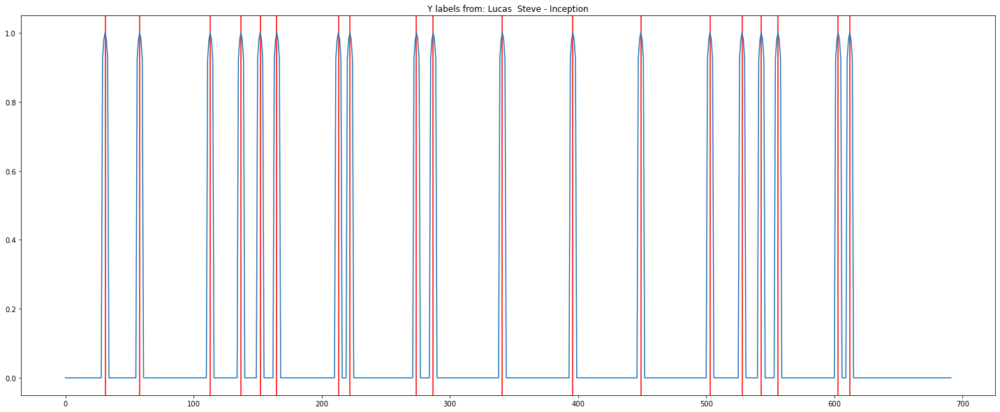

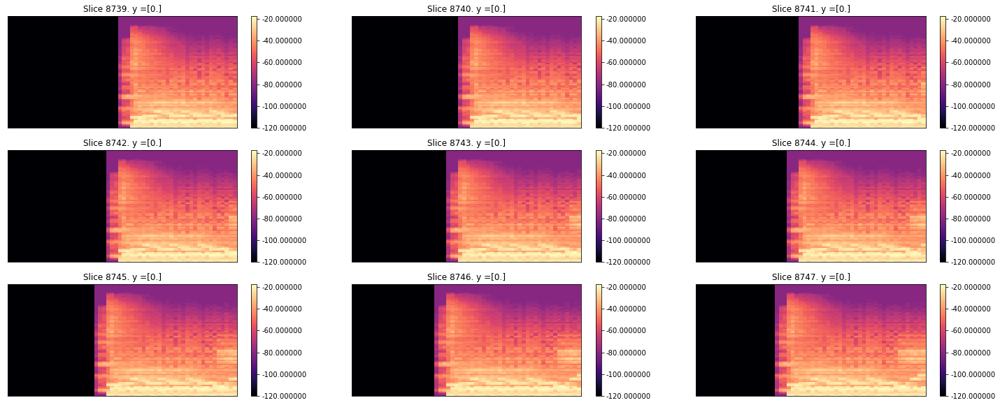

In [14]:
n=12
test_ds.show_features(n_song=n, slice = None)
test_ds.play_song(n_song=n)

## LOAD MODEL / GET MODEL PREDICTS / BAGGING / SHOW RESULTS


In [5]:
#load model
model = load_model("High_8_1p5_Dropout_1.h5")

Model succesfully loaded


In [52]:
#get preds from a model
test_ds.predict(model)

In [9]:
#get preds from the mean of n_models
test_ds.pred_labels = bagging(test_ds, n_models=5, res="Low", context=16, smear=1.5, extra="Dropout")

Model succesfully loaded
Model succesfully loaded
Model succesfully loaded
Model succesfully loaded
Model succesfully loaded


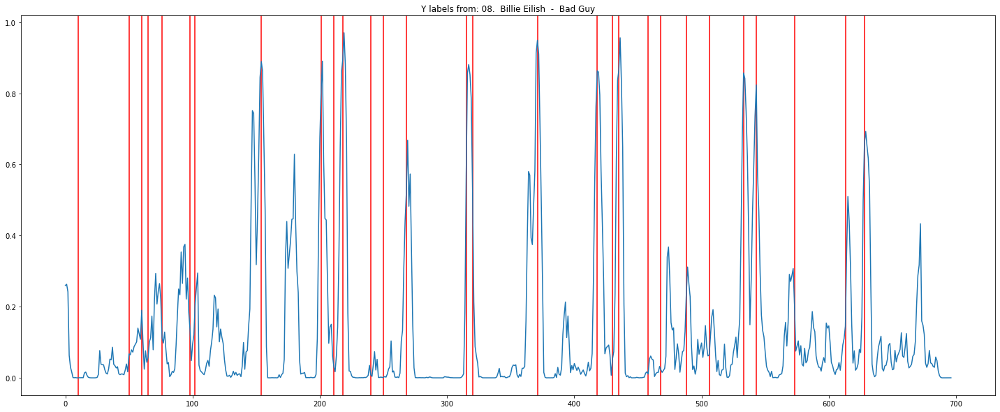

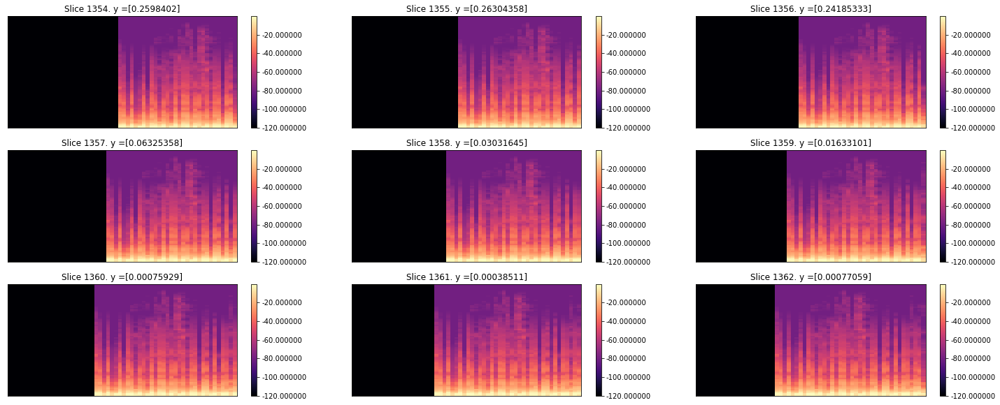

In [15]:
#Show predictions
test_ds.show_features(n_song=3, slice=None, pred=True)
test_ds.play_song(3)

## Getting Results - F score


### Peak Picking Predictions


In [7]:
# Get peaks from certain height and been maximum over certain distance
peaks, _ = find_peaks(test_ds.pred_labels[:,0], height=0.005, distance = 3)

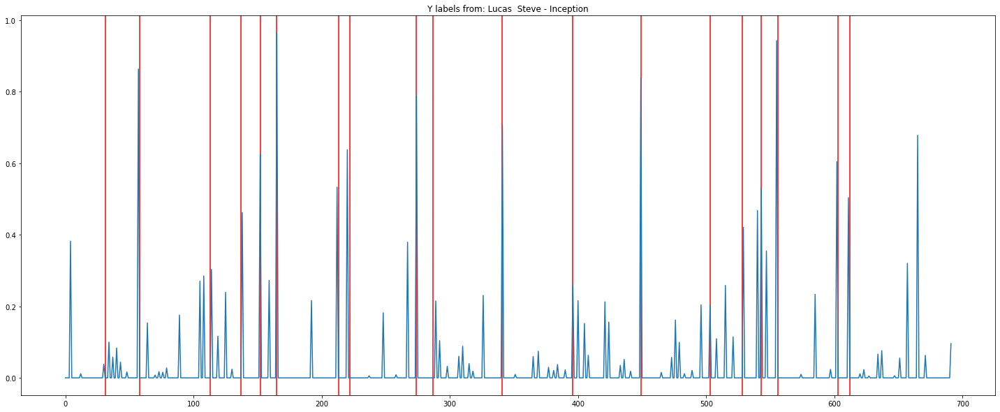

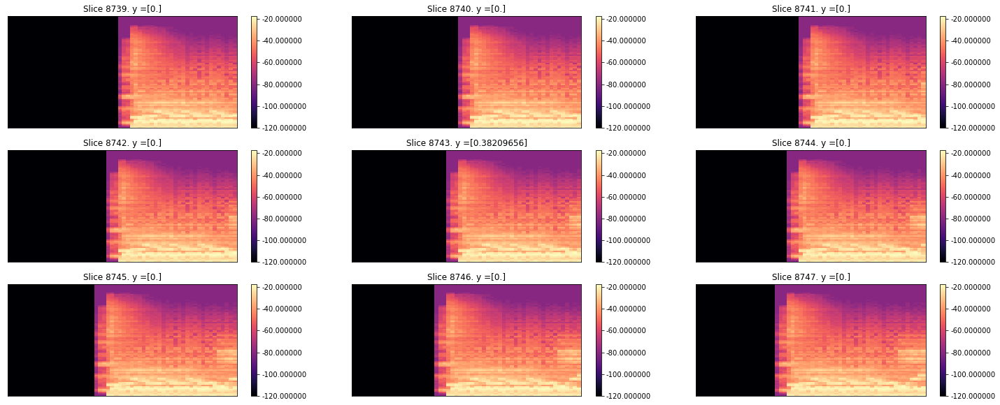

In [8]:
# Showing selected peaks for evaluation, warning!! old predictions will be removed.
y_detected = np.zeros((test_ds.Y_data.shape[0], 1))
for frame in range(y_detected.shape[0]):
            if frame in peaks:
                y_detected[frame,:] = test_ds.pred_labels[frame,0]


test_ds.pred_labels = y_detected
test_ds.show_features(n_song=12,slice=None, pred=True)                

## Choose best threshold for results

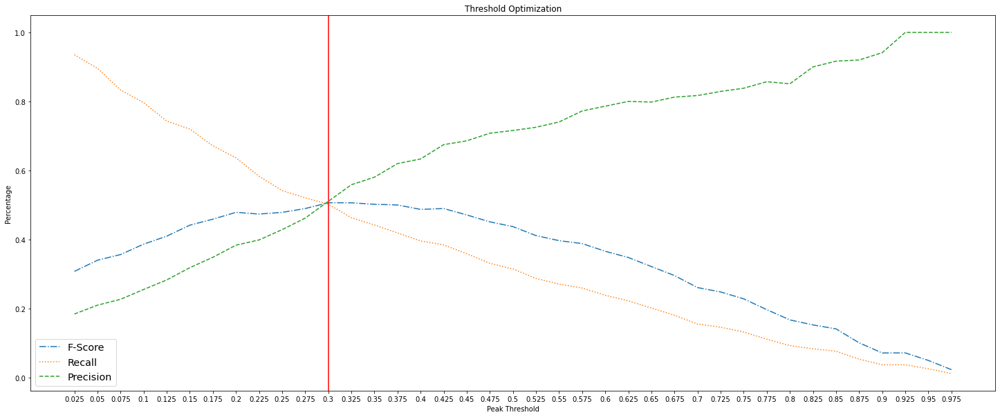

Optimum Height set at 0.3


In [19]:
threshold_optimization(test_ds, tol=3, distance=3, res="Low")

## FINAL RESULTS
After chosing the best threshold and apply bagging to the number of trained model, we make final results for indexing to final results table

In [18]:
y_labels_index = np.where(test_ds.oY_data > 0)[0]
peaks, _ = find_peaks(test_ds.pred_labels[:,0], height=0.3, distance = 7)
f_score, recall, precision = cal_f_score(y_labels_index, peaks, tol=3, res="Low")

print("----------------- RESULTS ---------------------------------- \n")
print(f"F-Score: {round(f_score,4)}, Recall: {round(recall,4)}, Precision: {round(precision,4)}")

----------------- RESULTS ---------------------------------- 

F-Score: 0.5296, Recall: 0.4861, Precision: 0.5817
